<a href="https://colab.research.google.com/github/ashaoluayanfe/data-science-and-analytics/blob/main/Classification_of_emotions.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Classification of emotions

## Importing the libraries

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from google.colab.patches import cv2_imshow
import zipfile
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout, Conv2D, MaxPooling2D, Flatten, BatchNormalization

## Loading the images

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
path = '/content/drive/MyDrive/Deep_learning/Computer Vision Masterclass/Datasets/fer_images.zip'
zip_object = zipfile.ZipFile(file=path, mode='r')
zip_object.extractall('./')
zip_object.close()

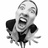

In [ ]:
tf.keras.preprocessing.image.load_img('/content/fer2013/train/Angry/1003.jpg')

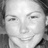

In [ ]:
image = tf.keras.preprocessing.image.load_img('/content/fer2013/train/Happy/1.jpg')
image

### Train and test set

In [ ]:
training_generator = ImageDataGenerator(rescale=1./255,
                                        rotation_range=7,
                                        horizontal_flip=True,
                                        zoom_range=0.2)
train_dataset = training_generator.flow_from_directory('/content/fer2013/train',
                                                        target_size = (48, 48),
                                                        batch_size = 16,
                                                        class_mode = 'categorical',
                                                        shuffle = True)

Found 28709 images belonging to 7 classes.


In [ ]:
train_dataset.classes

array([0, 0, 0, ..., 6, 6, 6], dtype=int32)

In [ ]:
np.unique(train_dataset.classes, return_counts=True)

(array([0, 1, 2, 3, 4, 5, 6], dtype=int32),
 array([3995,  436, 4097, 7215, 4965, 4830, 3171]))

In [ ]:
train_dataset.class_indices

{'Angry': 0,
 'Disgust': 1,
 'Fear': 2,
 'Happy': 3,
 'Neutral': 4,
 'Sad': 5,
 'Surprise': 6}

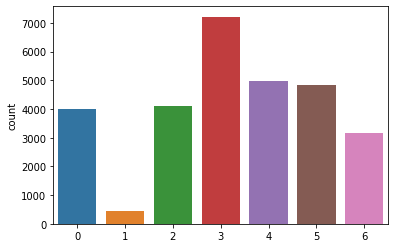

In [ ]:
sns.countplot(x = train_dataset.classes);

In [ ]:
test_generator = ImageDataGenerator(rescale=1./255)
test_dataset = test_generator.flow_from_directory('/content/fer2013/validation',
                                                  target_size = (48, 48),
                                                  batch_size = 1,
                                                  class_mode = 'categorical',
                                                  shuffle = False)

Found 3589 images belonging to 7 classes.


## Building and training the convolutional neural network

In [ ]:
2*2*2*32

256

In [ ]:
# Based on: https://github.com/rajeevratan84/DeepLearningCV/blob/master/18.2%20Building%20an%20Emotion%20Detector%20with%20LittleVGG.ipynb
# Padding: https://www.pico.net/kb/what-is-the-difference-between-same-and-valid-padding-in-tf-nn-max-pool-of-tensorflow
# BatchNormalization: https://keras.io/api/layers/normalization_layers/batch_normalization/
# Dropout: https://jmlr.org/papers/volume15/srivastava14a.old/srivastava14a.pdf
num_detectors = 32
num_classes = 7
width, height = 48, 48
epochs = 70

network = Sequential()

network.add(Conv2D(num_detectors, (3,3), activation='relu', padding = 'same', input_shape = (width, height, 3)))
network.add(BatchNormalization())
network.add(Conv2D(num_detectors, (3,3), activation='relu', padding = 'same'))
network.add(BatchNormalization())
network.add(MaxPooling2D(pool_size=(2,2)))
network.add(Dropout(0.2))

network.add(Conv2D(2*num_detectors, (3,3), activation='relu', padding = 'same'))
network.add(BatchNormalization())
network.add(Conv2D(2*num_detectors, (3,3), activation='relu', padding = 'same'))
network.add(BatchNormalization())
network.add(MaxPooling2D(pool_size=(2,2)))
network.add(Dropout(0.2))

network.add(Conv2D(2*2*num_detectors, (3,3), activation='relu', padding = 'same'))
network.add(BatchNormalization())
network.add(Conv2D(2*2*num_detectors, (3,3), activation='relu', padding = 'same'))
network.add(BatchNormalization())
network.add(MaxPooling2D(pool_size=(2,2)))
network.add(Dropout(0.2))

network.add(Conv2D(2*2*2*num_detectors, (3,3), activation='relu', padding = 'same'))
network.add(BatchNormalization())
network.add(Conv2D(2*2*2*num_detectors, (3,3), activation='relu', padding = 'same'))
network.add(BatchNormalization())
network.add(MaxPooling2D(pool_size=(2,2)))
network.add(Dropout(0.2))

network.add(Flatten())

network.add(Dense(2 * num_detectors, activation='relu'))
network.add(BatchNormalization())
network.add(Dropout(0.2))

network.add(Dense(2 * num_detectors, activation='relu'))
network.add(BatchNormalization())
network.add(Dropout(0.2))

network.add(Dense(num_classes, activation='softmax'))
print(network.summary())

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 32)        896       
                                                                 
 batch_normalization (BatchN  (None, 48, 48, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 32)        9248      
                                                                 
 batch_normalization_1 (Batc  (None, 48, 48, 32)       128       
 hNormalization)                                                 
                                                                 
 max_pooling2d (MaxPooling2D  (None, 24, 24, 32)       0         
 )                                                               
                                                        

In [ ]:
network.compile(optimizer='Adam', loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
callback = tf.keras.callbacks.EarlyStopping(monitor='loss', patience=3)

In [ ]:
network.fit(train_dataset, epochs=epochs, callbacks=[callback])

Epoch 1/70
1795/1795 [==============================] - 40s 23ms/step - loss: 1.8093 - accuracy: 0.2793
Epoch 2/70
1795/1795 [==============================] - 41s 23ms/step - loss: 1.5248 - accuracy: 0.4051
Epoch 3/70
1795/1795 [==============================] - 40s 22ms/step - loss: 1.3813 - accuracy: 0.4701
Epoch 4/70
1795/1795 [==============================] - 39s 22ms/step - loss: 1.3040 - accuracy: 0.5032
Epoch 5/70
1795/1795 [==============================] - 40s 22ms/step - loss: 1.2506 - accuracy: 0.5284
Epoch 6/70
1795/1795 [==============================] - 40s 22ms/step - loss: 1.2072 - accuracy: 0.5468
Epoch 7/70
1795/1795 [==============================] - 41s 23ms/step - loss: 1.1752 - accuracy: 0.5593
Epoch 8/70
1795/1795 [==============================] - 40s 22ms/step - loss: 1.1456 - accuracy: 0.5732
Epoch 9/70
1795/1795 [==============================] - 39s 22ms/step - loss: 1.1202 - accuracy: 0.5830
Epoch 10/70
1795/1795 [==============================] - 39s 22m

## Saving and loading the model

In [ ]:
network.save('/content/drive/MyDrive/models')

INFO:tensorflow:Assets written to: /content/drive/MyDrive/models/assets


In [ ]:
from tensorflow import keras
network_loaded = keras.models.load_model('/content/drive/MyDrive/ml_models/emotion_classification_models')

In [ ]:
network_loaded.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 48, 48, 32)        896       
                                                                 
 batch_normalization (BatchN  (None, 48, 48, 32)       128       
 ormalization)                                                   
                                                                 
 conv2d_1 (Conv2D)           (None, 48, 48, 32)        9248      
                                                                 
 batch_normalization_1 (Batc  (None, 48, 48, 32)       128       
 hNormalization)                                                 
                                                                 
 max_pooling2d (MaxPooling2D  (None, 24, 24, 32)       0         
 )                                                               
                                                        

## Evaluating the neural network

In [ ]:
network_loaded.evaluate(test_dataset)

3589/3589 [==============================] - 27s 5ms/step - loss: 1.3825 - accuracy: 0.5731


[1.3825362920761108, 0.5731401443481445]

In [ ]:
predictions = network_loaded.predict(test_dataset)
predictions

array([[5.1595122e-01, 1.8507458e-03, 6.4574778e-02, ..., 2.6200348e-01,
        1.4189017e-01, 1.2315047e-02],
       [9.5394623e-01, 5.2987154e-05, 4.0800862e-02, ..., 1.4871701e-04,
        3.4853822e-04, 3.4521744e-03],
       [8.6073273e-01, 1.3249296e-03, 6.3050516e-02, ..., 6.8336171e-03,
        5.7256658e-02, 3.3442108e-03],
       ...,
       [4.9316837e-03, 9.1902533e-05, 2.8274933e-01, ..., 1.3909864e-02,
        1.0168445e-02, 6.8296176e-01],
       [3.4821474e-03, 3.4940196e-05, 1.5812559e-01, ..., 2.6890369e-02,
        4.1641858e-03, 8.0100513e-01],
       [1.4590274e-02, 2.0582255e-04, 4.5484174e-02, ..., 1.3713432e-02,
        1.0982977e-02, 8.3567679e-01]], dtype=float32)

In [ ]:
predictions = np.argmax(predictions, axis = 1)
predictions

array([0, 0, 0, ..., 6, 6, 6])

In [ ]:
test_dataset.classes

array([0, 0, 0, ..., 6, 6, 6], dtype=int32)

In [ ]:
from sklearn.metrics import accuracy_score
accuracy_score(test_dataset.classes, predictions)

0.5731401504597381

In [ ]:
test_dataset.class_indices

{'Angry': 0,
 'Disgust': 1,
 'Fear': 2,
 'Happy': 3,
 'Neutral': 4,
 'Sad': 5,
 'Surprise': 6}

In [ ]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(test_dataset.classes, predictions)
cm

array([[279,   6,  49,  13,  75,  59,  10],
       [ 13,  32,   2,   2,   2,   3,   1],
       [ 57,   4, 237,  17,  76,  77,  60],
       [ 21,   0,   8, 770,  43,  19,  18],
       [ 81,   8,  80, 156, 133,  99,  69],
       [ 45,   1,  72,  41, 141, 283,  11],
       [  8,   0,  45,  19,  16,   5, 323]])

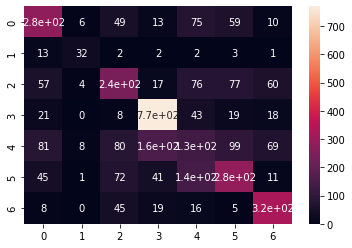

In [ ]:
sns.heatmap(cm, annot=True);

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(test_dataset.classes, predictions))

              precision    recall  f1-score   support

           0       0.55      0.57      0.56       491
           1       0.63      0.58      0.60        55
           2       0.48      0.45      0.46       528
           3       0.76      0.88      0.81       879
           4       0.27      0.21      0.24       626
           5       0.52      0.48      0.50       594
           6       0.66      0.78      0.71       416

    accuracy                           0.57      3589
   macro avg       0.55      0.56      0.56      3589
weighted avg       0.55      0.57      0.56      3589



## Classifying one single image

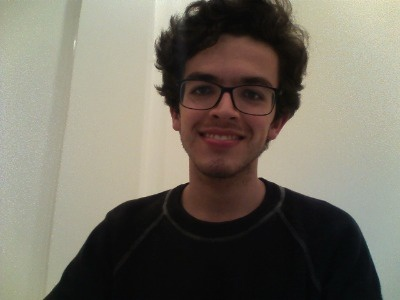

In [ ]:
image = cv2.imread('/content/drive/MyDrive/Deep_learning/Computer Vision Masterclass/Images/gabriel.png')
cv2_imshow(image)

In [ ]:
image.shape

(300, 400, 3)

In [ ]:
face_detector = cv2.CascadeClassifier('/content/drive/MyDrive/Deep_learning/Computer Vision Masterclass/Cascades/haarcascade_frontalface_default.xml')

In [ ]:
original_image = image.copy()
faces = face_detector.detectMultiScale(original_image)

In [ ]:
faces

array([[162,  40, 128, 128]], dtype=int32)

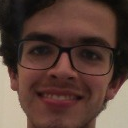

In [ ]:
roi = image[40:40 + 128, 162:162 + 128]
cv2_imshow(roi)

In [ ]:
roi.shape

(128, 128, 3)

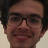

In [ ]:
roi = cv2.resize(roi, (48, 48))
cv2_imshow(roi)

In [ ]:
roi.shape

(48, 48, 3)

In [ ]:
roi

array([[[ 28,  32,  37],
        [ 22,  28,  34],
        [ 33,  37,  42],
        ...,
        [ 12,  16,  17],
        [ 16,  21,  25],
        [ 16,  25,  30]],

       [[ 27,  31,  36],
        [ 31,  36,  41],
        [ 32,  36,  41],
        ...,
        [ 11,  16,  19],
        [ 13,  19,  24],
        [ 17,  25,  28]],

       [[ 27,  31,  36],
        [ 30,  34,  39],
        [ 26,  30,  35],
        ...,
        [ 12,  17,  20],
        [ 14,  20,  25],
        [ 20,  25,  27]],

       ...,

       [[162, 185, 197],
        [166, 188, 200],
        [166, 188, 200],
        ...,
        [162, 181, 188],
        [162, 182, 188],
        [161, 180, 187]],

       [[160, 184, 196],
        [165, 187, 199],
        [166, 188, 200],
        ...,
        [161, 180, 187],
        [162, 181, 187],
        [161, 180, 187]],

       [[160, 184, 196],
        [163, 187, 199],
        [165, 187, 199],
        ...,
        [160, 179, 186],
        [161, 180, 187],
        [162, 181, 188]]

In [ ]:
roi = roi / 255
roi

array([[[0.10980392, 0.1254902 , 0.14509804],
        [0.08627451, 0.10980392, 0.13333333],
        [0.12941176, 0.14509804, 0.16470588],
        ...,
        [0.04705882, 0.0627451 , 0.06666667],
        [0.0627451 , 0.08235294, 0.09803922],
        [0.0627451 , 0.09803922, 0.11764706]],

       [[0.10588235, 0.12156863, 0.14117647],
        [0.12156863, 0.14117647, 0.16078431],
        [0.1254902 , 0.14117647, 0.16078431],
        ...,
        [0.04313725, 0.0627451 , 0.0745098 ],
        [0.05098039, 0.0745098 , 0.09411765],
        [0.06666667, 0.09803922, 0.10980392]],

       [[0.10588235, 0.12156863, 0.14117647],
        [0.11764706, 0.13333333, 0.15294118],
        [0.10196078, 0.11764706, 0.1372549 ],
        ...,
        [0.04705882, 0.06666667, 0.07843137],
        [0.05490196, 0.07843137, 0.09803922],
        [0.07843137, 0.09803922, 0.10588235]],

       ...,

       [[0.63529412, 0.7254902 , 0.77254902],
        [0.65098039, 0.7372549 , 0.78431373],
        [0.65098039, 0

In [ ]:
roi.shape

(48, 48, 3)

In [ ]:
roi = np.expand_dims(roi, axis = 0)
roi.shape

(1, 48, 48, 3)

In [ ]:
probs = network_loaded.predict(roi)
probs

array([[2.3071570e-03, 2.9883697e-05, 1.0575561e-03, 8.4818500e-01,
        1.4493613e-01, 2.6094958e-03, 8.7488175e-04]], dtype=float32)

In [ ]:
result = np.argmax(probs)
result

3

In [ ]:
test_dataset.class_indices

{'Angry': 0,
 'Disgust': 1,
 'Fear': 2,
 'Happy': 3,
 'Neutral': 4,
 'Sad': 5,
 'Surprise': 6}

## Classifying multiple images

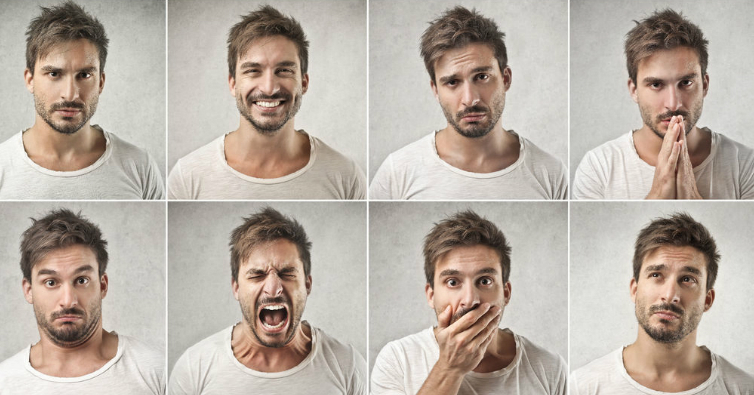

In [ ]:
image = cv2.imread('/content/drive/MyDrive/Deep_learning/Computer Vision Masterclass/Images/faces_emotions.png')
cv2_imshow(image)

In [ ]:
faces = face_detector.detectMultiScale(image)
faces

array([[224,  35,  90,  90],
       [625,  49,  91,  91],
       [ 23,  41,  92,  92],
       [420,  43,  97,  97],
       [420, 242,  97,  97],
       [ 18, 243,  98,  98],
       [229, 242,  85,  85],
       [627, 241,  91,  91]], dtype=int32)

In [ ]:
test_dataset.class_indices.keys()

dict_keys(['Angry', 'Disgust', 'Fear', 'Happy', 'Neutral', 'Sad', 'Surprise'])

In [ ]:
emotions = ['Angry', 'Disgust', 'Fear', 'Happy', 'Neutral', 'Sad', 'Surprise']

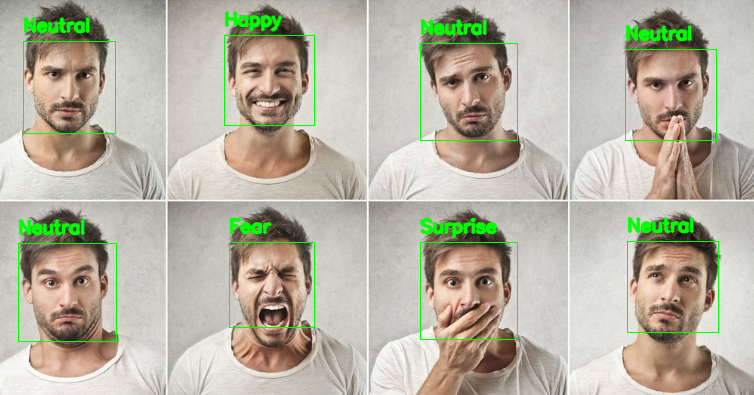

In [ ]:
for (x, y, w, h) in faces:
  cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 1)
  roi = image[y:y + h, x:x + w]
  #cv2_imshow(roi)
  roi = cv2.resize(roi, (48, 48))
  #cv2_imshow(roi)
  roi = roi / 255
  roi = np.expand_dims(roi, axis = 0)
  #print(roi.shape)
  prediction = network_loaded.predict(roi)
  #print(prediction)
  cv2.putText(image, emotions[np.argmax(prediction)], (x, y - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, (0,255,0), 2, cv2.LINE_AA)
cv2_imshow(image)

## Classifying emotions in videos

In [ ]:
cap = cv2.VideoCapture('/content/drive/MyDrive/Deep_learning/Computer Vision Masterclass/Videos/emotion_test01.mp4')
connected, video = cap.read()
print(connected, video.shape)

True (360, 640, 3)


In [ ]:
# fourcc.org
save_path = '/content/drive/MyDrive/Deep_learning/Computer Vision Masterclass/Videos/emotion_test01_result.avi'
fourcc = cv2.VideoWriter_fourcc(*'XVID')
fps = 24
output_video = cv2.VideoWriter(save_path, fourcc, fps, (video.shape[1], video.shape[0]))

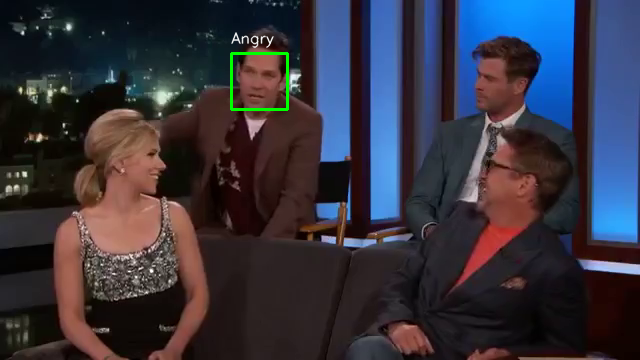

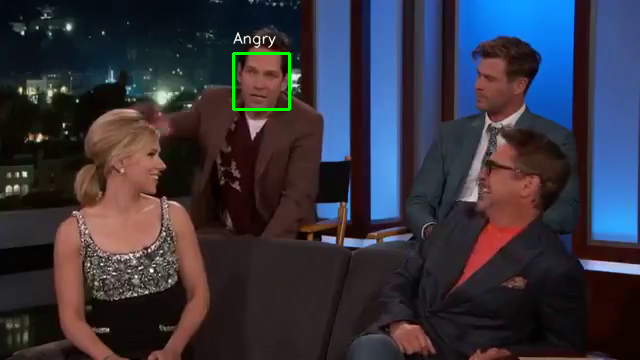

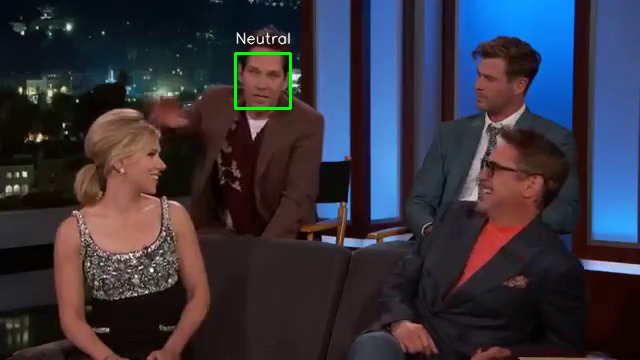

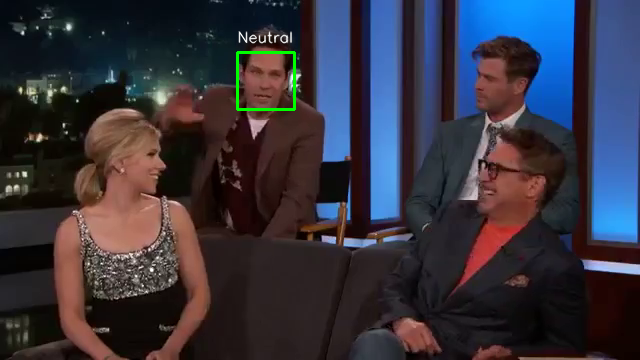

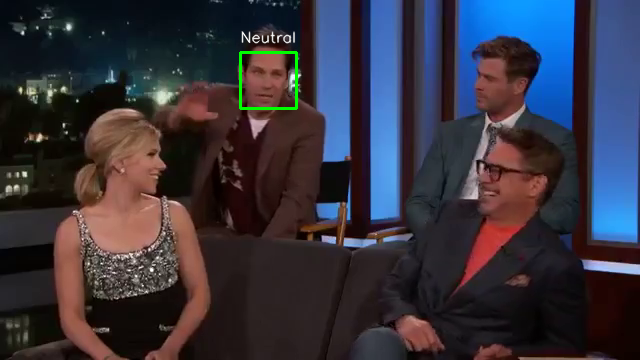

...

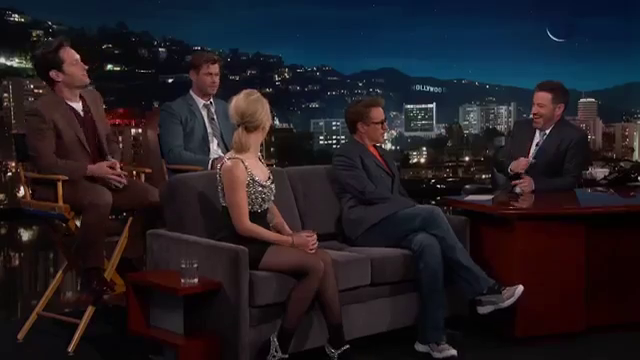

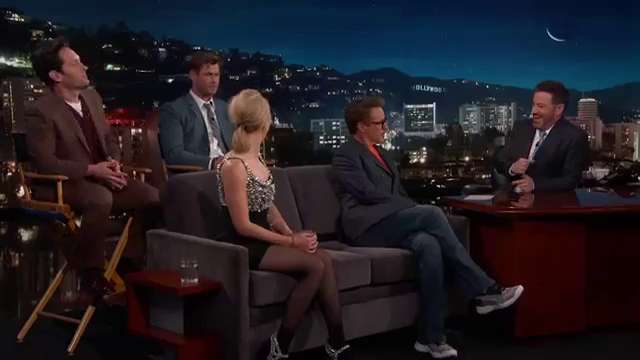

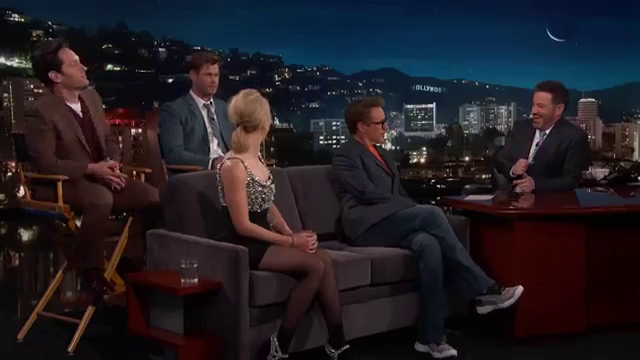

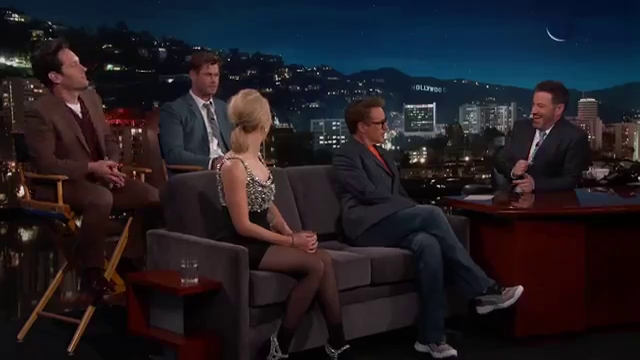

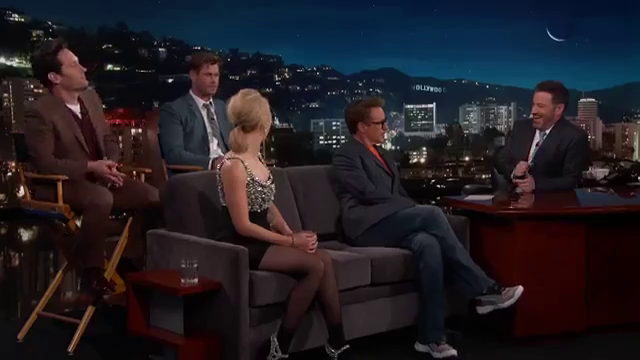

End


In [ ]:
while (cv2.waitKey(1) < 0):
  connected, frame = cap.read()
  if not connected:
    break
  faces = face_detector.detectMultiScale(frame, scaleFactor=1.2, minNeighbors=5, minSize=(30,30))
  if len(faces) > 0:
    for (x, y, w, h) in faces:
      frame = cv2.rectangle(frame, (x, y), (x + w, y + h), (0, 255, 0), 2)
      roi = frame[y:y + h, x:x + w]
      roi = cv2.resize(roi, (48, 48))
      roi = roi / 255
      roi = np.expand_dims(roi, axis = 0)
      prediction = network_loaded.predict(roi)

      if prediction is not None:
        result = np.argmax(prediction)
        cv2.putText(frame, emotions[result], (x, y-10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, (255,255,255), 1, cv2.LINE_AA)
  
  cv2_imshow(frame)
  output_video.write(frame)

print('End')
output_video.release()
cv2.destroyAllWindows()